# 1. Import Dependencies and Modular Classes

In [1]:
import sys
sys.path.append("../")  # So I can import from solar_modules

from solar_modules.data_loader import DataLoader
from solar_modules.data_cleaner import DataCleaner
from solar_modules.visualizer import DataVisualizer
import pandas as pd

# 2. Load the Dataset

In [ ]:
filepath = '../data/raw/sierraleone-bumbuna.csv'
loader = DataLoader(filepath)
df = loader.load_data()

In [4]:
df.head(10) #use this to check the first 10 rows of the dataframe

,Timestamp,GHI,DNI,DHI,ModA,ModB,Tamb,RH,WS,WSgust,WSstdev,WD,WDstdev,BP,Cleaning,Precipitation,TModA,TModB,Comments
0,2021-10-30 00:01:00,-0.7,-0.1,-0.8,0.0,0.0,21.9,99.1,0.0,0.0,0.0,0.0,0.0,1002,0,0.0,22.3,22.6,NaN
1,2021-10-30 00:02:00,-0.7,-0.1,-0.8,0.0,0.0,21.9,99.2,0.0,0.0,0.0,0.0,0.0,1002,0,0.0,22.3,22.6,NaN
2,2021-10-30 00:03:00,-0.7,-0.1,-0.8,0.0,0.0,21.9,99.2,0.0,0.0,0.0,0.0,0.0,1002,0,0.0,22.3,22.6,NaN
3,2021-10-30 00:04:00,-0.7,0.0,-0.8,0.0,0.0,21.9,99.3,0.0,0.0,0.0,0.0,0.0,1002,0,0.1,22.3,22.6,NaN
4,2021-10-30 00:05:00,-0.7,-0.1,-0.8,0.0,0.0,21.9,99.3,0.0,0.0,0.0,0.0,0.0,1002,0,0.0,22.3,22.6,NaN
5,2021-10-30 00:06:00,-0.7,-0.1,-0.8,0.0,0.0,21.9,99.3,0.0,0.0,0.0,0.0,0.0,1002,0,0.0,22.3,22.7,NaN
6,2021-10-30 00:07:00,-0.7,0.0,-0.8,0.0,0.0,22.0,99.4,0.1,0.7,0.2,240.4,0.0,1002,0,0.0,22.3,22.7,NaN
7,2021-10-30 00:08:00,-0.7,0.0,-0.8,0.0,0.0,22.0,99.5,0.2,0.7,0.4,233.5,1.6,1002,0,0.0,22.4,22.7,NaN
8,2021-10-30 00:09:00,-0.7,-0.1,-0.8,0.0,0.0,22.0,99.5,0.7,1.1,0.5,232.0,0.3,1002,0,0.0,22.4,22.7,NaN
9,2021-10-30 00:10:00,-0.7,-0.1,-0.8,0.0,0.0,21.9,99.2,0.6,1.1,0.5,232.5,0.3,1002,0,0.0,22.4,22.7,NaN


In [3]:
df.tail(10) #use this to check the last 10 rows of the dataframe

,Timestamp,GHI,DNI,DHI,ModA,ModB,Tamb,RH,WS,WSgust,WSstdev,WD,WDstdev,BP,Cleaning,Precipitation,TModA,TModB,Comments
525590,2022-10-29 23:51:00,-1.2,-0.1,-2.3,0.0,0.0,24.0,100.0,0.0,0.0,0.0,0.0,0.0,1000,0,0.0,24.3,24.6,NaN
525591,2022-10-29 23:52:00,-1.2,-0.1,-2.3,0.0,0.0,24.0,100.0,0.0,0.0,0.0,0.0,0.0,1000,0,0.0,24.3,24.6,NaN
525592,2022-10-29 23:53:00,-1.3,-0.1,-2.4,0.0,0.0,24.0,100.0,0.0,0.0,0.0,0.0,0.0,1000,0,0.0,24.3,24.6,NaN
525593,2022-10-29 23:54:00,-1.4,-0.1,-2.5,0.0,0.0,24.0,100.0,0.0,0.0,0.0,0.0,0.0,1000,0,0.0,24.2,24.6,NaN
525594,2022-10-29 23:55:00,-1.5,-0.1,-2.7,0.0,0.0,24.0,100.0,0.0,0.0,0.0,0.0,0.0,1000,0,0.0,24.2,24.5,NaN
525595,2022-10-29 23:56:00,-1.6,-0.1,-2.9,0.0,0.0,24.0,100.0,0.0,0.0,0.0,0.0,0.0,999,0,0.0,24.2,24.5,NaN
525596,2022-10-29 23:57:00,-1.7,-0.1,-3.0,0.0,0.0,24.0,100.0,0.0,0.0,0.0,0.0,0.0,999,0,0.0,24.2,24.5,NaN
525597,2022-10-29 23:58:00,-1.7,-0.1,-3.1,0.0,0.0,24.0,100.0,0.0,0.0,0.0,0.0,0.0,1000,0,0.0,24.1,24.4,NaN
525598,2022-10-29 23:59:00,-1.7,-0.2,-3.3,0.0,0.0,23.9,100.0,0.0,0.0,0.0,0.0,0.0,1000,0,0.0,24.1,24.4,NaN
525599,2022-10-30 00:00:00,-1.7,-0.1,-3.4,0.0,0.0,23.9,100.0,0.0,0.0,0.0,0.0,0.0,1000,0,0.0,24.1,24.4,NaN


# 3. Clean the Data (Outliers & Missing Values)

In [5]:
columns = ['GHI', 'DNI', 'DHI', 'ModA', 'ModB', 'WS', 'WSgust'] #this is the list of columns that we want to clean
cleaner = DataCleaner(df, columns) #this is the cleaner object that we want to use to clean the data
cleaner.handle_outliers() #this is the method that we want to use to handle the outliers    
cleaner.handle_missing() #this is the method that we want to use to handle the missing values
df = cleaner.get_cleaned_data() #this is the method that we want to use to get the cleaned data

# Optionally, see missing value report
missing_report = cleaner.generate_missing_value_report() #this is the method that we want to use to generate the missing value report
display(missing_report) #this is the method that we want to use to display the missing value report

,Missing Values,Percent
Comments,525600,100.0


# 4. Save the Cleaned Data

In [6]:
cleaned_path = '../data/sierraleone_clean.csv' #this is the path to the cleaned data        
df.to_csv(cleaned_path, index=False) #this is the method that we want to use to save the cleaned data
print(f'Cleaned data saved to {cleaned_path}') #this is the method that we want to use to print the cleaned data

Cleaned data saved to ../data/sierraleone_clean.csv


#  5. Visualize the Data

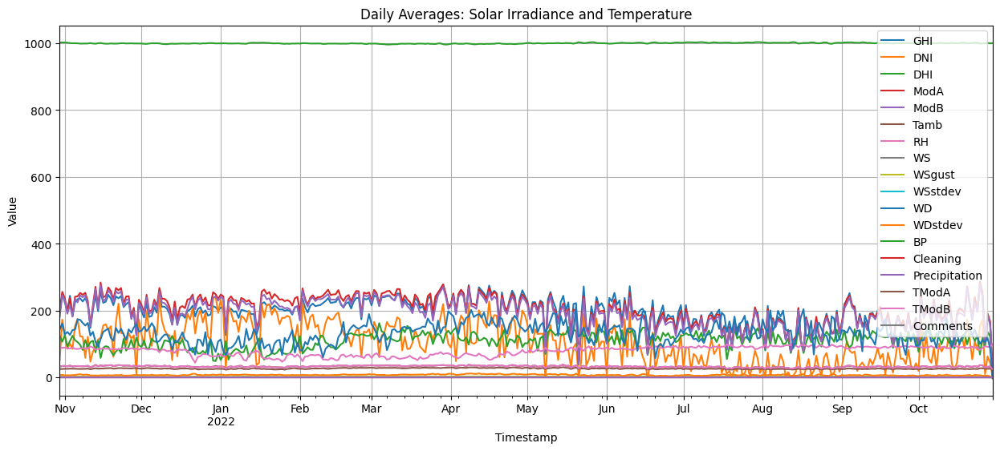

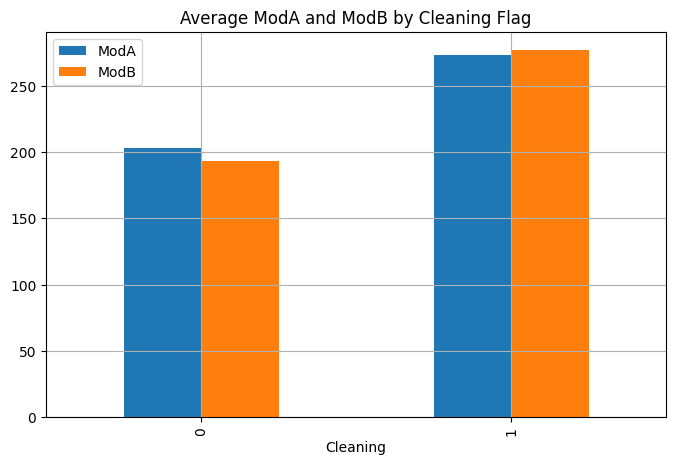

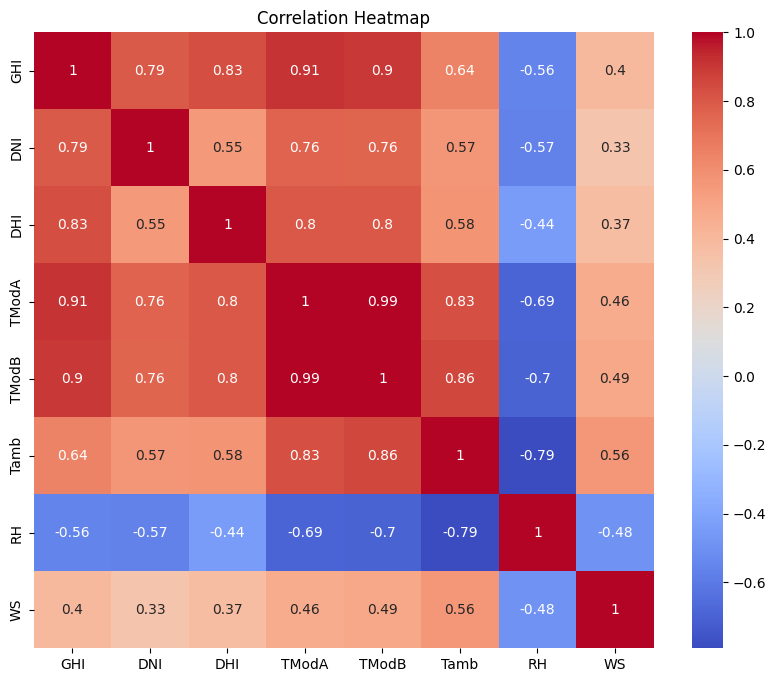

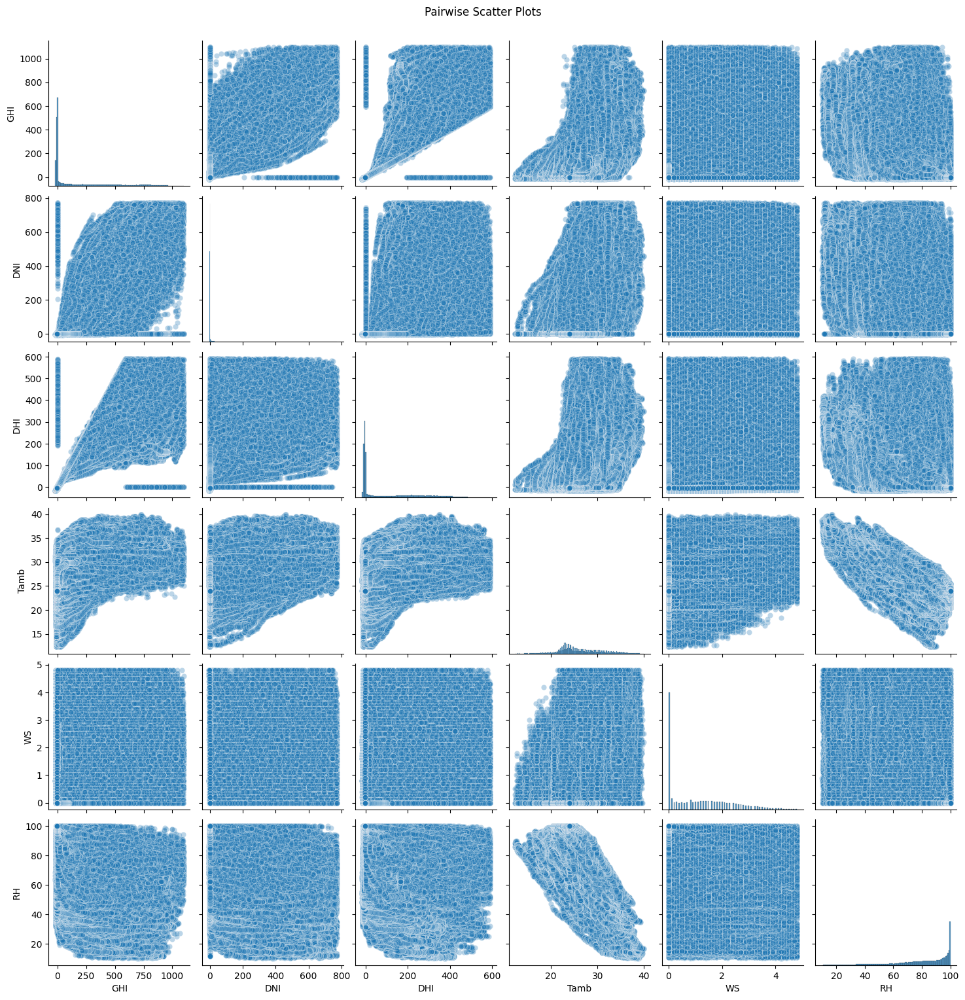

c:\Users\hp\Desktop\KAIM-solar-challenge-week0\notebooks\..\solar_modules\visualizer.py:45: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  wind_avg = wind_data.groupby('WD_bin')['WS'].mean().reset_index()


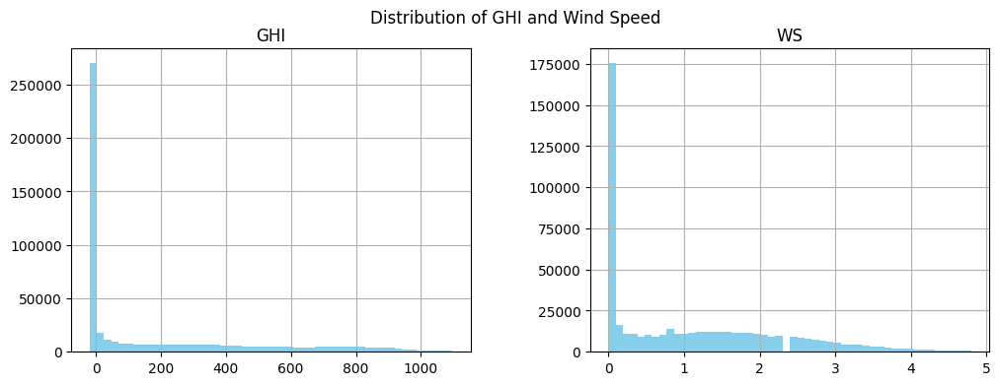

In [7]:
viz = DataVisualizer(df) #this is the visualizer object that we want to use to visualize the data   
viz.plot_time_series() #this is the method that we want to use to plot the time series
viz.plot_cleaning_impact() #this is the method that we want to use to plot the cleaning impact
viz.plot_correlation_heatmap() #this is the method that we want to use to plot the correlation heatmap
viz.plot_pairwise_scatter() #this is the method that we want to use to plot the pairwise scatter
viz.plot_wind_rose() #this is the method that we want to use to plot the wind rose
viz.plot_histograms() #this is the method that we want to use to plot the histograms
viz.plot_bubble_chart() #this is the method that we want to use to plot the bubble chart